In [1]:
# Read Images and save them to a list

import cv2
import os, os.path
import glob
import numpy as np
import random

img_list = []
path = ".\\Cohn-Kanade\\neutral"
png_files = glob.glob(os.path.join(path, '*.png'))
num_png_files = len(png_files)

for img in png_files:
    img_list.append(cv2.cvtColor(cv2.imread(img) , cv2.COLOR_BGR2GRAY) )

# cv2.imshow('Original', img_list[10]) 
# cv2.waitKey(0) 
# cv2.destroyAllWindows()
# print(img_list[0].shape)

twoD_to_vec = lambda mat: mat.reshape(-1).T
vec_images = list(map(twoD_to_vec, img_list))
# print(len(vec_images), "  ", vec_images[10].shape)
random.shuffle(vec_images)
train_set, test_set = vec_images[:70], vec_images[70:]
# print(len(train_set))



In [1]:
# Mean, Subs and Eigenface calculation

from sklearn import decomposition
import matplotlib.pyplot as plt

# print(len(sub_imgs))

pca = decomposition.PCA(n_components=20, whiten=True)
pca.fit(train_set)

# print(pca.components_.shape)
# plt.imshow(pca.mean_.reshape(img_list[0].shape))

fig = plt.figure(figsize=(80, 60))
for i in range(10):
    ax = fig.add_subplot(1, 10, i + 1, xticks=[], yticks=[])
    ax.imshow(pca.components_[i].reshape(img_list[0].shape), cmap=plt.cm.bone)
    # print(pca.components_[i].shape)


NameError: name 'train_set' is not defined

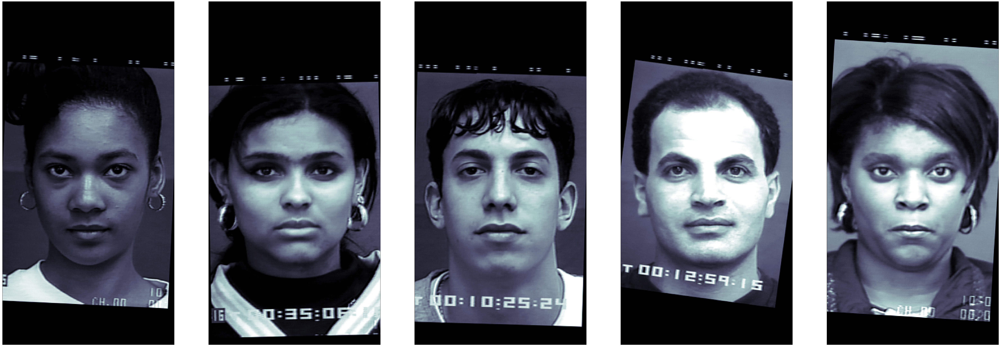

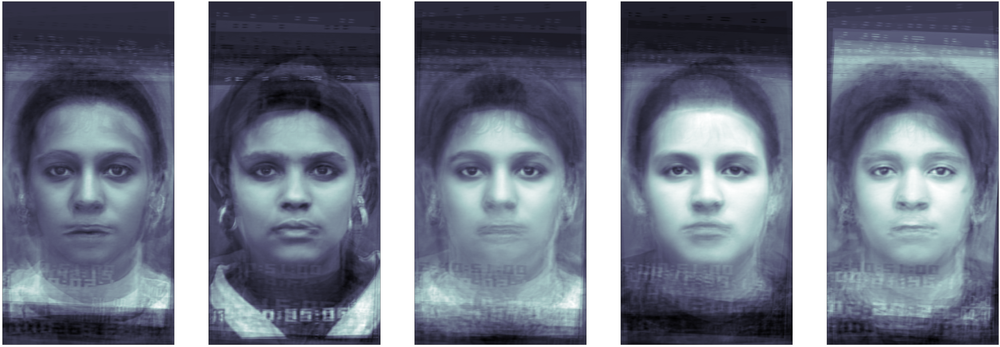

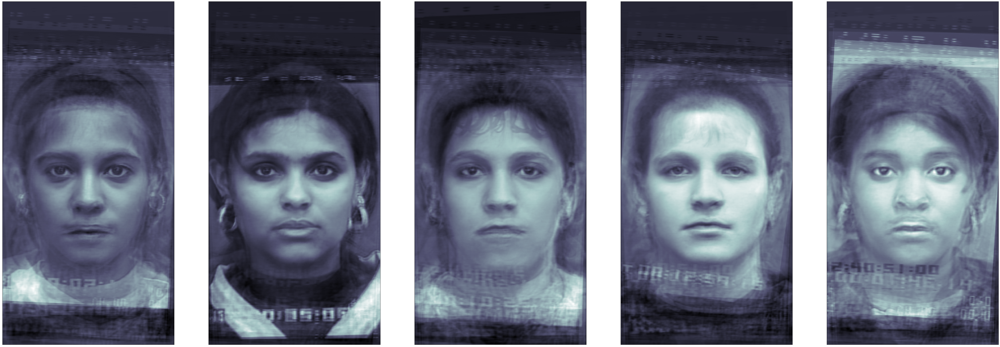

In [ ]:
from sklearn.feature_extraction import image

def projection(image, mean, eigen_vecs):
    eig_vec_matrix = np.array(eigen_vecs).T
    projected_img = np.dot((image-mean).T, eig_vec_matrix)
    # for i in range(len(eigen_vecs)):
    #     projected_img[i] = np.dot((image-mean).T, eigen_vecs[i])

    return projected_img

def reconstruction(proj_coef, eigen_vecs, mean):
    image_vec = np.dot(proj_coef.T, eigen_vecs) + mean
    return image_vec

eigen_faces = pca.components_[:10]
A = np.array(eigen_faces[0:10]).T #Create A matrix

eig_val, eig_vec = np.linalg.eigh(np.dot(A.T,A))  #Find eigens for ATA

real_eig_vec = np.dot(A, eig_vec).T #Find eigens for AAT
faces_mean = pca.mean_

#############################################

target_recunst_imags = train_set[65:70]
fig = plt.figure(figsize=(80, 60))
for i in range(5):
    ax = fig.add_subplot(1, 5, i + 1, xticks=[], yticks=[])
    ax.imshow(target_recunst_imags[i].reshape(img_list[0].shape), cmap=plt.cm.bone)

################################################
projected_images = []
for i in range(5):
    projected_images.append(projection(target_recunst_imags[i], faces_mean, real_eig_vec))

recunsted_images1 = []
fig = plt.figure(figsize=(80, 60))
for i in range(5):
    recunsted_images1.append(reconstruction(projected_images[i], real_eig_vec, faces_mean))
    ax = fig.add_subplot(1, 5, i + 1, xticks=[], yticks=[])
    ax.imshow(recunsted_images1[i].reshape(img_list[0].shape), cmap=plt.cm.bone)

# print(len(pca.components_))
################################################















eigen_faces = pca.components_[:20]
A = np.array(eigen_faces).T #Create A matrix

eig_val, eig_vec = np.linalg.eigh(np.dot(A.T,A))  #Find eigens for ATA

real_eig_vec = np.dot(A, eig_vec).T #Find eigens for AAT
faces_mean = pca.mean_

#############################################

projected_images = []
for i in range(5):
    projected_images.append(projection(target_recunst_imags[i], faces_mean, real_eig_vec))

recunsted_images1 = []
fig = plt.figure(figsize=(80, 60))
for i in range(5):
    recunsted_images1.append(reconstruction(projected_images[i], real_eig_vec, faces_mean))
    ax = fig.add_subplot(1, 5, i + 1, xticks=[], yticks=[])
    ax.imshow(recunsted_images1[i].reshape(img_list[0].shape), cmap=plt.cm.bone)

# print(len(pca.components_))
################################################3




واضح است هرچند که تصاویر بازسازی شده با 20 بردار ویژه به تصاویر اصلی نزدیکتر هستند، اما عمده تصویر ساخته شده با همان 10 بردار ویژه اول است و این ده بردار ویژه بیشترین تاثیر را در بازسازی چهره افراد داشته اند 
که با توجه به اینکه ما بردار های ویژه را بر اساس اندازه واریانسشان مرتب کرده ایم 
طبیعی بود که انتظار داشته باشیم به همین ترتیب اثرگذاری بیشتری داشته باشند

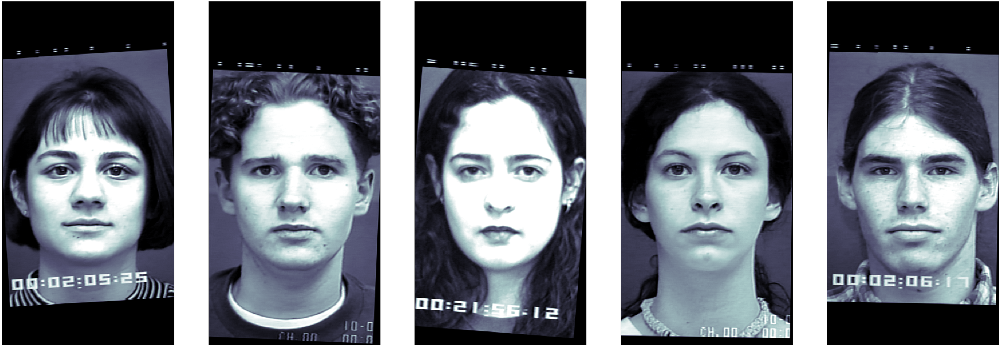

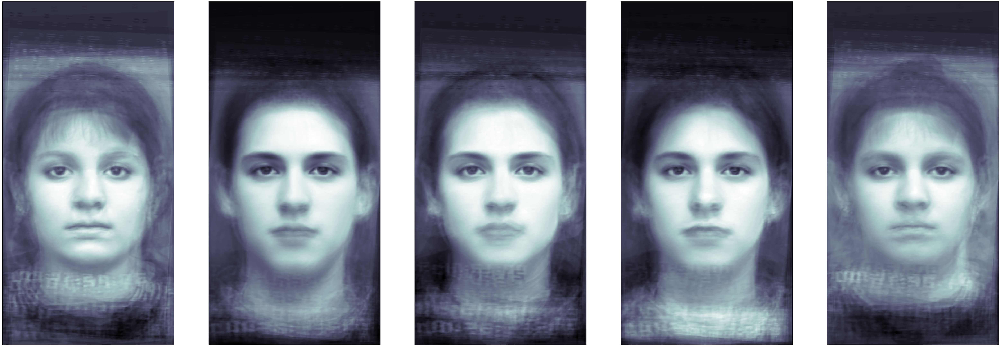

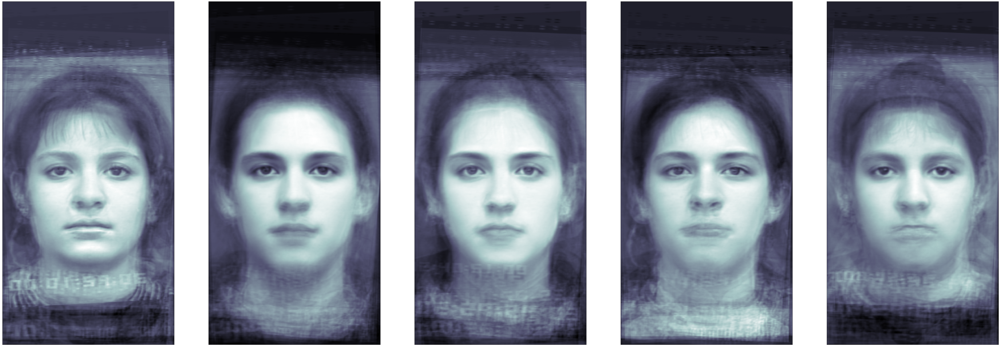

In [ ]:
eigen_faces = pca.components_[:10]
A = np.array(eigen_faces).T #Create A matrix

eig_val, eig_vec = np.linalg.eigh(np.dot(A.T,A))  #Find eigens for ATA

real_eig_vec = np.dot(A, eig_vec).T #Find eigens for AAT
faces_mean = pca.mean_

target_recunst_imags = test_set[:5]
fig = plt.figure(figsize=(80, 60))
for i in range(5):
    ax = fig.add_subplot(1, 5, i + 1, xticks=[], yticks=[])
    ax.imshow(target_recunst_imags[i].reshape(img_list[0].shape), cmap=plt.cm.bone)

################################################
projected_images = []
for i in range(5):
    projected_images.append(projection(target_recunst_imags[i], faces_mean, real_eig_vec))

recunsted_images1 = []
fig = plt.figure(figsize=(80, 60))
for i in range(5):
    recunsted_images1.append(reconstruction(projected_images[i], real_eig_vec, faces_mean))
    ax = fig.add_subplot(1, 5, i + 1, xticks=[], yticks=[])
    ax.imshow(recunsted_images1[i].reshape(img_list[0].shape), cmap=plt.cm.bone)

# print(len(pca.components_))
################################################















eigen_faces = pca.components_[:20]
A = np.array(eigen_faces).T #Create A matrix

eig_val, eig_vec = np.linalg.eigh(np.dot(A.T,A))  #Find eigens for ATA

real_eig_vec = np.dot(A, eig_vec).T #Find eigens for AAT
faces_mean = pca.mean_

#############################################

projected_images = []
for i in range(5):
    projected_images.append(projection(target_recunst_imags[i], faces_mean, real_eig_vec))

recunsted_images1 = []
fig = plt.figure(figsize=(80, 60))
for i in range(5):
    recunsted_images1.append(reconstruction(projected_images[i], real_eig_vec, faces_mean))
    ax = fig.add_subplot(1, 5, i + 1, xticks=[], yticks=[])
    ax.imshow(recunsted_images1[i].reshape(img_list[0].shape), cmap=plt.cm.bone)

# print(len(pca.components_))
################################################3

هرچند مشابه با قسمت قبل، تصاویر بازسازی شده با 20 بردار ویژه برتر کیفیت مطلوب تر و 
شباهت بیشتری به تصویر اصلیشان در مقایسه با تصاویر بازسازی شده با 10 بردار ویژه برتر دارند، اما نکته اینجاست 
که در مجموع این تصاویر نسبت به تصاویر قبل بازسازی بدتری داشته اند.

به این معنا که تصاویر بازسازی شده چه با 10 بردار چه با 20 بردار ویژه برتر در بخش قبل، شباهت بیشتری به تصویر اصلی شان داشتند نسبت به تصاویر بازسازی شده در این قسمت. علت هم واضح است. ما پایه های متعامد که مبنای باز سازی تصاویر هستند را از مجموعه تصاویری انتخاب کردیم که تصاویر بخش قبل در آن بودند. بنابر این تصاویر نقش مستقیمی در 
ساخت این بردار های ویژه داشته اند و به نوعی این بردار های ویژه از خواص همین تصویر ها ساخته شده بنابراین تصویر شدن این تصاویر به فضای برآمده از این بردار ویژه ها اطلاعات کمتری را از دست میدهد (در مقایسه با تصاویر دسته دوم که در محاسبه بردار های ویژه یاد شده نقشی نداشتند)

In [ ]:
# Read Images and save them to a list
img = cv2.imread(".\\Cohn-Kanade\\neutral\\S011_001_03141424_n.png")

mask = np.ones_like(img)*255
cv2.rectangle(mask, (0, 0), (300, 180), (0, 0, 0), thickness=cv2.FILLED)
cv2.rectangle(mask, (180, 0), (300, 175), (0, 0, 0), thickness=cv2.FILLED)
cv2.rectangle(mask, (0, 180), (65, 220), (0, 0, 0), thickness=cv2.FILLED)
cv2.rectangle(mask, (225, 180), (300, 220), (0, 0, 0), thickness=cv2.FILLED)
cv2.rectangle(mask, (0, 220), (45, 455), (0, 0, 0), thickness=cv2.FILLED)
cv2.rectangle(mask, (255, 220), (300, 455), (0, 0, 0), thickness=cv2.FILLED)
cv2.rectangle(mask, (0, 455), (300, 600), (0, 0, 0), thickness=cv2.FILLED)
mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)
# print(mask.shape)
# print(img.shape)
# cv2.imshow('Original', mask) 
# cv2.waitKey(0) 
# cv2.destroyAllWindows()

neutral = []
path_neutral = ".\\Cohn-Kanade\\neutral"
png_files_neutral = glob.glob(os.path.join(path_neutral, '*.png'))
for img in png_files_neutral:
    neutral.append(cv2.bitwise_and(cv2.cvtColor(cv2.imread(img) , cv2.COLOR_BGR2GRAY), mask))
vec_images_neutral = list(map(twoD_to_vec, neutral))
random.shuffle(vec_images_neutral)
train_set_neutral, test_set_neutral = vec_images_neutral[:70], vec_images_neutral[70:]

surprise = []
path_surprise = ".\\Cohn-Kanade\\surprise"
png_files_happy = glob.glob(os.path.join(path_happy, '*.png'))
for img in png_files_happy:
    happy.append(cv2.bitwise_and(cv2.cvtColor(cv2.imread(img) , cv2.COLOR_BGR2GRAY), mask))
vec_images_happy = list(map(twoD_to_vec, happy))
random.shuffle(vec_images_happy)
train_set_happy, test_set_happy = vec_images_happy[:70], vec_images_happy[70:]

surprise = []
path_surprise = ".\\Cohn-Kanade\\surprise"
png_files_surprise = glob.glob(os.path.join(path_surprise, '*.png'))
for img in png_files_surprise:
    surprise.append(cv2.bitwise_and(cv2.cvtColor(cv2.imread(img) , cv2.COLOR_BGR2GRAY), mask))
vec_images_surprise = list(map(twoD_to_vec, surprise))
random.shuffle(vec_images_surprise)
train_set_surprise, test_set_surprise = vec_images_surprise[:70], vec_images_surprise[70:]

disgust = []
path_disgust = ".\\Cohn-Kanade\\disgust"
png_files_disgust = glob.glob(os.path.join(path_disgust, '*.png'))
for img in png_files_disgust:
    disgust.append(cv2.bitwise_and(cv2.cvtColor(cv2.imread(img) , cv2.COLOR_BGR2GRAY), mask))
vec_images_disgust = list(map(twoD_to_vec, disgust))
random.shuffle(vec_images_disgust)
train_set_disgust, test_set_disgust = vec_images_disgust[:70], vec_images_disgust[70:]

# cv2.imshow('Original', happy[10]) 
# cv2.waitKey(0) 
# cv2.destroyAllWindows()

# twoD_to_vec = lambda mat: mat.reshape(-1).T
# vec_images = list(map(twoD_to_vec, img_list))
# # print(len(vec_images), "  ", vec_images[10].shape)
# random.shuffle(vec_images)
# train_set, test_set = vec_images[:70], vec_images[70:]
# print(len(train_set))

pca_neutral = decomposition.PCA(n_components=20, whiten=True)
pca_neutral.fit(train_set_neutral)
pca_happy = decomposition.PCA(n_components=20, whiten=True)
pca_happy.fit(train_set_happy)
pca_surprise = decomposition.PCA(n_components=20, whiten=True)
pca_surprise.fit(train_set_surprise)
pca_disgust = decomposition.PCA(n_components=20, whiten=True)
pca_disgust.fit(train_set_disgust)


PCA(n_components=20, whiten=True)

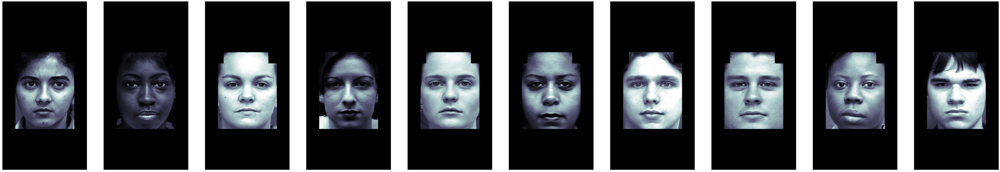

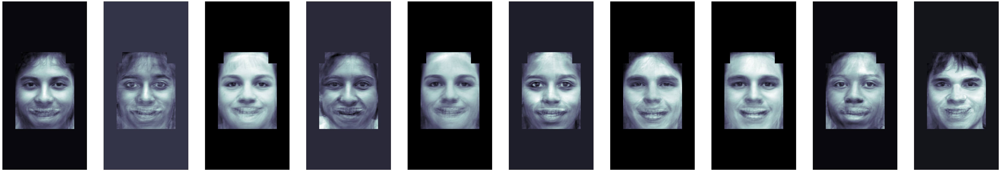

In [ ]:
eigen_faces_happy = pca_happy.components_[:20]
A = np.array(eigen_faces_happy).T #Create A matrix

eig_val_happy, eig_vec_happy = np.linalg.eigh(np.dot(A.T,A))  #Find eigens for ATA

real_eig_vec_happy = np.dot(A, eig_vec_happy).T #Find eigens for AAT
faces_mean_happy = pca_happy.mean_

#############################################

target_recunst_imags_happy = train_set_neutral[:10]
fig = plt.figure(figsize=(80, 60))
for i in range(10):
    ax = fig.add_subplot(1, 10, i + 1, xticks=[], yticks=[])
    ax.imshow(target_recunst_imags_happy[i].reshape(img_list[0].shape), cmap=plt.cm.bone)

################################################
projected_images_happy = []
for i in range(10):
    projected_images_happy.append(projection(target_recunst_imags_happy[i], faces_mean_happy, real_eig_vec_happy))

recunsted_images_happy = []
fig = plt.figure(figsize=(80, 60))
for i in range(10):
    recunsted_images_happy.append(reconstruction(projected_images_happy[i], real_eig_vec_happy, faces_mean_happy))
    ax = fig.add_subplot(1, 10, i + 1, xticks=[], yticks=[])
    ax.imshow(recunsted_images_happy[i].reshape(img_list[0].shape), cmap=plt.cm.bone)

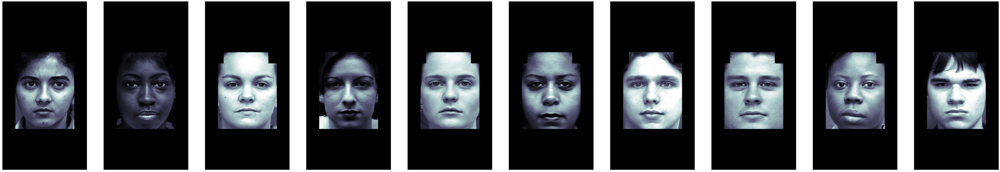

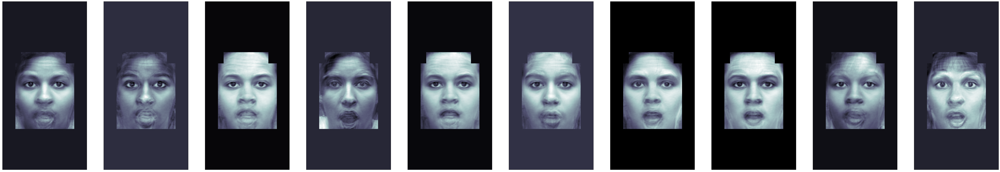

In [ ]:
eigen_faces_surprise = pca_surprise.components_[:20]
A = np.array(eigen_faces_surprise).T #Create A matrix

eig_val_surprise, eig_vec_surprise = np.linalg.eigh(np.dot(A.T,A))  #Find eigens for ATA

real_eig_vec_surprise = np.dot(A, eig_vec_surprise).T #Find eigens for AAT
faces_mean_surprise = pca_surprise.mean_

#############################################

target_recunst_imags_surprise = train_set_neutral[:10]
fig = plt.figure(figsize=(80, 60))
for i in range(10):
    ax = fig.add_subplot(1, 10, i + 1, xticks=[], yticks=[])
    ax.imshow(target_recunst_imags_surprise[i].reshape(img_list[0].shape), cmap=plt.cm.bone)

################################################
projected_images_surprise = []
for i in range(10):
    projected_images_surprise.append(projection(target_recunst_imags_surprise[i], faces_mean_surprise, real_eig_vec_surprise))

recunsted_images_surprise = []
fig = plt.figure(figsize=(80, 60))
for i in range(10):
    recunsted_images_surprise.append(reconstruction(projected_images_surprise[i], real_eig_vec_surprise, faces_mean_surprise))
    ax = fig.add_subplot(1, 10, i + 1, xticks=[], yticks=[])
    ax.imshow(recunsted_images_surprise[i].reshape(img_list[0].shape), cmap=plt.cm.bone)

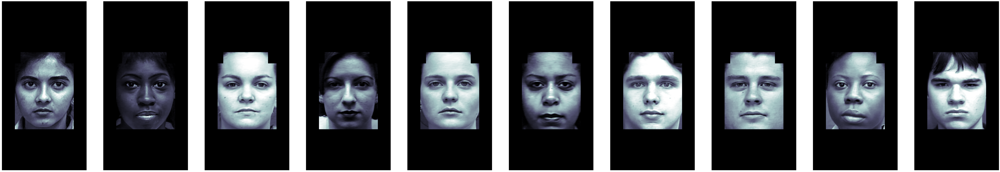

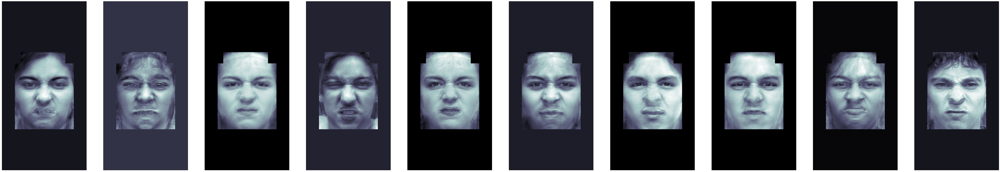

In [ ]:
eigen_faces_disgust = pca_disgust.components_[:20]
A = np.array(eigen_faces_disgust).T #Create A matrix

eig_val_disgust, eig_vec_disgust = np.linalg.eigh(np.dot(A.T,A))  #Find eigens for ATA

real_eig_vec_disgust = np.dot(A, eig_vec_disgust).T #Find eigens for AAT
faces_mean_disgust = pca_disgust.mean_

#############################################

target_recunst_imags_disgust = train_set_neutral[:10]
fig = plt.figure(figsize=(100, 75))
for i in range(10):
    ax = fig.add_subplot(1, 10, i + 1, xticks=[], yticks=[])
    ax.imshow(target_recunst_imags_disgust[i].reshape(img_list[0].shape), cmap=plt.cm.bone)

################################################
projected_images_disgust = []
for i in range(10):
    projected_images_disgust.append(projection(target_recunst_imags_disgust[i], faces_mean_disgust, real_eig_vec_disgust))

recunsted_images_disgust = []
fig = plt.figure(figsize=(100, 75))
for i in range(10):
    recunsted_images_disgust.append(reconstruction(projected_images_disgust[i], real_eig_vec_disgust, faces_mean_disgust))
    ax = fig.add_subplot(1, 10, i + 1, xticks=[], yticks=[])
    ax.imshow(recunsted_images_disgust[i].reshape(img_list[0].shape), cmap=plt.cm.bone)

همانطور که از سه بخش بالا واضح است، قسمت هایی از صورت که در دو دسته مختلف تفاوت دارند، در واقع قسمت هایی از صورت 
که منجر میشوند حالت عادی به حالات خوشحال، سورپرایز شده و منزجر تغییر کند، در بازسازی نیز دچار ضعف هستند. اما سایر قسمت های صورت 
مانند گونه ها، ابرو ها، و در برخی حالات حتی بینی که در حالات مختلف مشابه هستند در بازسازی نیز عملکرد خوبی داشته اند. اما درمجموع بازسازی با 20 کامپوننت پر ارزش تر هم هویت اشخصاص را حفظ کرده است هم تا حدودی آن ها را از حس عادی به حس هدف تبدیل کرده است.